In [8]:
import numpy as np
import pandas as pd
import scipy.stats as scs 
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from scipy.stats import f

# Det givna datasettet. https://www.kaggle.com/datasets/shivam2503/diamonds
diamonds = pd.read_csv('diamonds.csv')

# Plotinställningar
sns.set(rc = {'figure.figsize':(10, 5)})
plt.style.use('dark_background')

#### Inlämningsuppgift - Statistiska Metoder AI23
---

# Diamonds

---

I denna rapport kommer jag att studera diamanternas volym och slipning för att sedan analysera korrelation och prediktion med diamanternas pris och rankningar.

In [9]:
# Tar bort de diamanter som har 0mm i x, y eller z och där med ingen volym.
diamonds = diamonds[diamonds['x'] > 0]
diamonds = diamonds[diamonds['y'] > 0]
diamonds = diamonds[diamonds['z'] > 0]

# Och tar bort de värsta outliers som det inte heller verkar som att det finns någon förklaring till i dokumentationen.
diamonds = diamonds[diamonds['x'] < 12]
diamonds = diamonds[diamonds['y'] < 12]
diamonds = diamonds[diamonds['z'] < 12]

# Lägger till en kolumn för volym.
diamonds['volume'] = diamonds['x'] * diamonds['y'] * diamonds['z']

Nedan ges en generell överblick av datans olika värden, samt de första fem datapunkterna för att ge en bild av hur datan ser ut.

In [10]:
display(diamonds.describe())
display(diamonds.head())

,carat,depth,table,price,x,y,z,volume
count,53917.000000,53917.000000,53917.000000,53917.000000,53917.000000,53917.000000,53917.000000,53917.000000
mean,0.797687,61.749565,57.456939,3930.910474,5.731605,5.733428,3.539409,129.802460
std,0.473777,1.432318,2.234069,3987.215003,1.119402,1.111272,0.691620,76.450353
min,0.200000,43.000000,43.000000,326.000000,3.730000,3.680000,1.070000,31.707984
25%,0.400000,61.000000,56.000000,949.000000,4.710000,4.720000,2.910000,65.188530
50%,0.700000,61.800000,57.000000,2401.000000,5.700000,5.710000,3.530000,114.840180
75%,1.040000,62.500000,59.000000,5323.000000,6.540000,6.540000,4.040000,170.844704
max,5.010000,79.000000,95.000000,18823.000000,10.740000,10.540000,6.980000,790.133208


,carat,cut,color,clarity,depth,table,price,x,y,z,volume
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43,38.202030
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31,34.505856
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31,38.076885
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63,46.724580
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75,51.917250


### Fokus: Diamanternas volym

Här finner vi att:

- Den genomsnittliga diamanten har volymen $129.8mm^3$ (Väntevärdet = $\mu$ = 129.80)
- med standardavvikelsen = $\sigma$ = 76.45
- och medianen 114.84

In [11]:
display(diamonds['volume'].describe())

count    53917.000000
mean       129.802460
std         76.450353
min         31.707984
25%         65.188530
50%        114.840180
75%        170.844704
max        790.133208
Name: volume, dtype: float64

Vi finner även att snedheten är åt höger då snedhetsvärdet är positivt.

In [12]:
volume = diamonds['volume']

print(f"Diamantvolymen har en snedhet på {volume.skew():.4f}, (alltså sned åt {"höger (grön linje nedan är åt höger)" if volume.skew() > 0 else "vänster (grön linje nedan är åt vänster)"}).")

Diamantvolymen har en snedhet på 1.1123, (alltså sned åt höger (grön linje nedan är åt höger)).


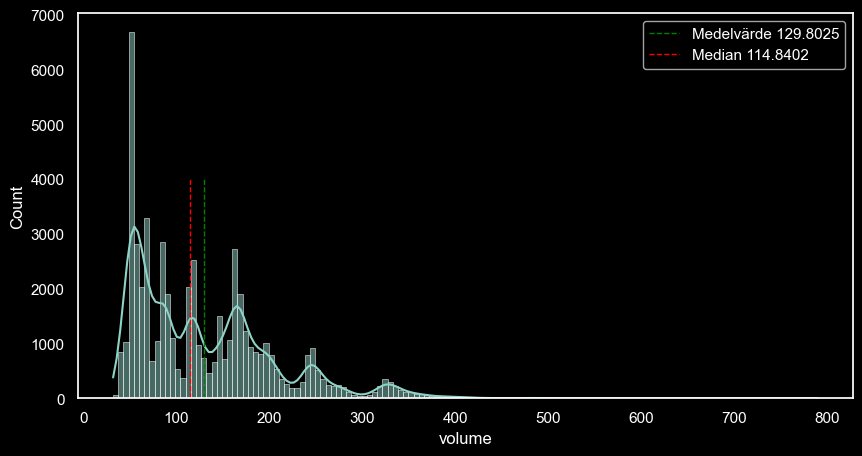

In [13]:
fig, ax = plt.subplots()
sns.histplot(volume, kde=True, ax=ax).grid(False)

plt.plot([volume.mean(), volume.mean()], [0, 4000], color='green', linestyle='--', linewidth=1, label=f'Medelvärde {volume.mean():.4f}')
plt.plot([volume.median(), volume.median()], [0, 4000], color='red', linestyle='--', linewidth=1, label=f'Median {volume.median():.4f}')

legend = plt.legend(loc='upper right')
plt.show()

In [14]:
# Jag fortsätter dela upp datan för att bespara plats och tydlighet lite längre ner.

# De relevanta kolumnerna är för mig i denna analys alltså de som enbart är numeriska.
relevant_columns = ['carat', 'depth', 'table', 'price', 'x', 'y', 'z', 'volume']

fair = diamonds[diamonds['cut']=='Fair'][relevant_columns]
good = diamonds[diamonds['cut']=='Good'][relevant_columns]
very_good = diamonds[diamonds['cut']=='Very Good'][relevant_columns]
premium = diamonds[diamonds['cut']=='Premium'][relevant_columns]
ideal = diamonds[diamonds['cut']=='Ideal'][relevant_columns]

cut = [fair, good, very_good, premium, ideal]

### Hypotestest och Konfidensintervall

Jag vill testa om volymen för de finast slipade diamanterna (ideal) är mindre än genomsnittsdiamanten. Detta med ett konfidensintervall om 95%.

- $H_A: \mu < E(x)_{ideal}$
- $H_0: \mu \geq E(x)_{ideal}$

In [15]:
print(ideal['volume'].mean())
print(diamonds['volume'].mean())

test1 = scs.ttest_1samp(a=ideal['volume'], popmean=diamonds['volume'].mean(), alternative='less')
print(test1)

print(test1.confidence_interval(confidence_level=0.95))

print()
print('Förkasta nollhypotesen.' if test1.pvalue < 0.05 else 'Förkasta ej nollhypotesen.')

115.3774186953172
129.80245957903813
TtestResult(statistic=-30.03403450853482, pvalue=1.7572114203502217e-194, df=21546)
ConfidenceInterval(low=-inf, high=116.16745910819986)

Förkasta nollhypotesen.


Jag vill testa om volymvariansen hos de sämst slipade diamanterna (Fair) är större än de volymen på de bäst slipade (Ideal).

- $H_A: \sigma^2_{Fair} > \sigma^2_{Ideal}$
- $H_0: \sigma^2_{Fair} \leq \sigma^2_{Ideal}$

In [16]:
F_statistic = np.var(fair['volume'], ddof=1) / np.var(ideal['volume'], ddof=1)
print('F-statistika: ' + str(F_statistic))

test2 = f.ppf(q=0.05, dfn=len(fair), dfd=len(ideal))
print('Critical F-värde: ' + str(test2))

print()
print(f'Förkasta nollhypotesen då {test2} < {F_statistic}.' if test2 < F_statistic else f'Förkasta ej nollhypotesen då {test2} > {F_statistic}.')

F-statistika: 1.304914207450654
Critical F-värde: 0.9407900845751018

Förkasta nollhypotesen då 0.9407900845751018 < 1.304914207450654.


Jag vill även skapa ett konfidensintervall på 95% för genomsnittskostnaden hos den näst bäst slipade diamanttypen (Premium).

In [17]:
sem = scs.sem(premium['price'])

lower, upper = scs.t.interval(0.95, len(premium['price'])-1, loc=premium['price'].mean(), scale=sem)

print(f"Genomsnittspriset för en premiumdiamant med 95% konfidensintervall: (${lower:.2f} - ${upper:.2f})")

Genomsnittspriset för en premiumdiamant med 95% konfidensintervall: ($4506.60 - $4651.66)


### Korrelationsanalys

Nedan testar jag hur de numeriska värdena i vår data korrelerar med varandra.

In [18]:
overall_corr = diamonds[relevant_columns].corr()
mask = np.triu(np.ones_like(overall_corr, dtype=bool))

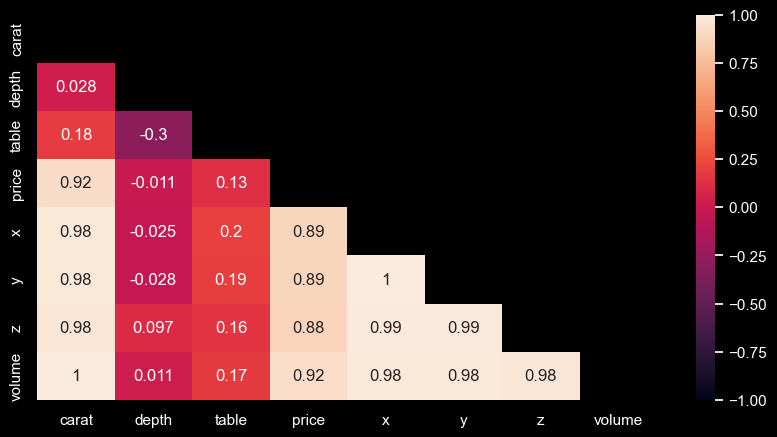

In [19]:
plt.style.use('dark_background')
sns.heatmap(overall_corr,
            mask=mask,
            annot=True,
            vmin=-1,
            vmax=1
            ).grid(False)

Till föga förvåning ser vi att diamanternas vikt (carat) och dess dimensioner/volym korrelerar högt med varandra, och dessa korrelerar i sin tur bra med priset. Intressant är hur lite allt annat verkar korrelera. Vi testar lite!

Låt oss istället se hur korrelationen skiljer sig för dessa kolumner om vi delar upp slipningen var för sig:

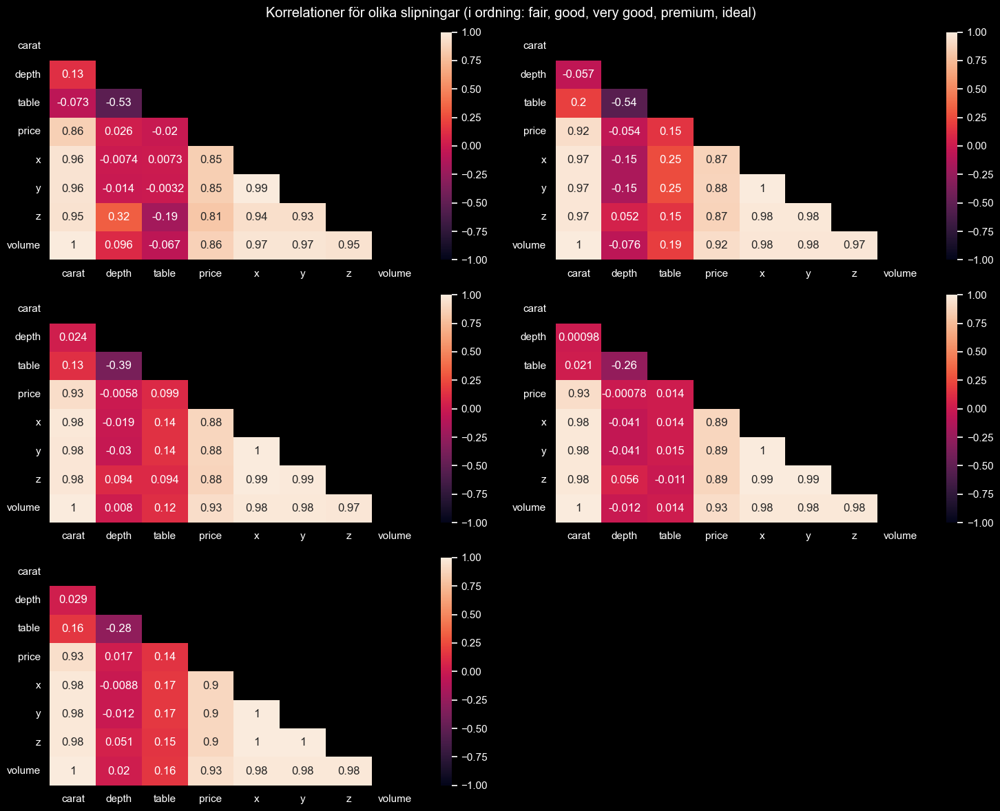

In [20]:
fig, ax = plt.subplots(3, 2, figsize=(15, 12))
ax = ax.flatten()

for i, subset in enumerate(cut):
    sns.heatmap(subset.corr(),
                mask=np.triu(np.ones_like(subset.corr(),dtype=bool)),
                annot=True,
                vmin=-1,
                vmax=1,
                ax=ax[i]
                ).grid(False)

for ax in ax[len(cut):]:
    ax.remove()

fig.suptitle('Korrelationer för olika slipningar (i ordning: fair, good, very good, premium, ideal)')

# ax[0].set_title('Fair')
# ax[1].set_title('Good')
# ax[2].set_title('Very Good')
# ax[3].set_title('Premium')
# ax[4].set_title('Ideal')

plt.tight_layout()

plt.show()


## Linjär regression

Här följer en stökig, men interaktiv plot som visar volymen i förhållande till priset. Testa gärna att klicka i och ur de olika slipningarna i legenden för att se trendlinjen. Till höger ses även fördelningen i violinplotten.

In [21]:
fig = px.scatter(
        diamonds,
        x='volume',
        y='price',
        color='cut',
        trendline='ols',
        title='Price vs Volume',
        labels={'volume':'Volume', 
                'price':'Price (USD)', 
                'clarity':'Clarity',
                'cut':'Cut',
                'color':'Color',
                'carat':'Carat',
                'depth':'Depth',
                },
        template='plotly_dark',
        hover_data=['carat', 
                'cut', 
                'color', 
                'depth', 
                'table', 
                'x', 'y', 'z',
                ],
        marginal_x='histogram',
        marginal_y='violin',
        )

fig.update_layout(autosize=False, width=1500, height=800, legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.80))

c:\Users\isaka\.virtualenvs\StatMetAi23-Isak-Andersson-e2nV03pU\Lib\site-packages\plotly\express\_core.py:2065: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  sf: grouped.get_group(s if len(s) > 1 else s[0])


Nedan följer en prediktionsmodell för ett stickprov av "very good" diamanternas prissättning jämfört deras karat.

(Denna ska jag erkänna att jag snott mycket från genomgångsdokumentet för. Jag menar, jag förstår vad jag har gjort tror jag, men jag hade inte kunnat göra det utan lite copy+paste. Vill bara vara ärlig! :D )

In [22]:
from statsmodels.formula.api import ols

# Jag gör ett slumpmässigt sample av 100 av de runt 12 000 som finns i datasettet.
very_good_sample = very_good.sample(100)

model = ols('carat ~ price', data=very_good_sample).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                  carat   R-squared:                       0.868
Model:                            OLS   Adj. R-squared:                  0.867
Method:                 Least Squares   F-statistic:                     644.1
Date:                Sun, 04 Feb 2024   Prob (F-statistic):           7.11e-45
Time:                        22:20:09   Log-Likelihood:                 37.242
No. Observations:                 100   AIC:                            -70.48
Df Residuals:                      98   BIC:                            -65.27
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.3489      0.026     13.644      0.0

Om vi nu skulle hitta en diamant som väger 5 karat och sedan som vi dessutom lyckas slipa till klassningen "very good" kan vi alltså med 95% säkerhet anta att den antagligen skulle kunna säljas för mellan $40 000 och $50 000!

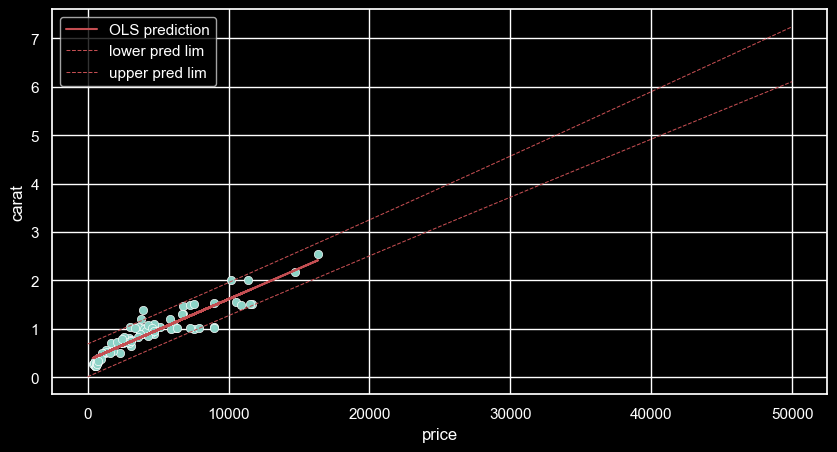

In [23]:
predictions = model.get_prediction(very_good_sample['price'])

frame=predictions.summary_frame(alpha=0.05)
ypred=frame['mean']

frame[['obs_ci_lower','obs_ci_upper']]

xs = pd.DataFrame(np.linspace(0,50000,200), columns=['price'])
#print(xs)

predictions = model.get_prediction(xs)
frame = predictions.summary_frame(alpha=0.05)
lower = frame['obs_ci_lower']
upper = frame['obs_ci_upper']

fig, ax = plt.subplots(figsize=(10,5))

sns.scatterplot(data=very_good_sample, x='price', y='carat')
ax.plot(very_good_sample['price'], ypred, "r", label="OLS prediction")

ax.plot(xs, lower, 'r--', label="lower pred lim", linewidth=0.75)
ax.plot(xs, upper, 'r--', label="upper pred lim", linewidth=0.75)

ax.legend(loc="best")
plt.show()